# Multi-Perspective Analysis

## Table of Contents

1. [Overview/Task](#intro)
2. [Data Exploration](#data)
3. [Education](#edu)
4. [Wealth](#wealth)
5. [Age](#feature)
6. [Ethnicity](#eth)
7. [Combine/JSON Data](#json)

<a id='intro'></a>
## 1. Overview/Task

##### Educational Analysis:
1. Find the average percentage of:
    - High school graduate percentage for all city 
    - Bachelor's degree percentage for all city 
2. Find the average supply/demand ratio by:
    - Below average high school graduation
    - Above High School graduation and Below Bachelor's degree
    - Above Bachelor's degree

##### Wealth Analysis:
1. Income:
    - Show line graph
        - X-axis: Total Average Income by city
        - Y-axis: supply/demand ratio by city
2. Property Value:
    - How to combine the values to identify the good property status?
        - Median value of owner-occupied housing units
        - Median selected monthly owner costs with a mortgage
        - Median selected monthly owner costs without a mortgage
        - Median gross rent
    - Show line graph
        - X-axis: good property values by city 
        - Y-axis: supply/demand ratio by city 

##### Age Analysis:
1. Find the between 18-65 group percentage 
2. Show line graph:
    - Trend of under 18 group 
        - X-axis: the percentage of this age group 
        - Y-axis: the supply/demand ratio 
    - Trend of between 18-65 group 
    - Trend of over 65 group 

##### Ethnicity Analysis:
1. Show the line graph for each ethnicity groups 
    - White percentage 
        - X-axis: the percentage of this ethnicity group 
        - Y-axis: the supply/demand ratio 
    - Black 
    - Native American 
    - Asian 
    - Pacific islander 

<a id='data'></a>
## 2. Data Exploration

- Load packages
- Read in population data
- Very quick automated EDA

In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import autoviz as av
import warnings
import os
from autoviz.AutoViz_Class import AutoViz_Class

warnings.filterwarnings('ignore')
%matplotlib inline

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine


In [2]:
df = pd.read_excel("../data/population.xlsx")

population_data = df.drop(df.columns[[3, 5, 7]], axis = 1)

population_data

,City,State,County,"Population Estimates, July 1 2021, (V2021)","Population estimates base, April 1, 2020, (V2021)","Population, percent change - April 1, 2020 (estimates base) to July 1, 2021, (V2021)","Population, Census, April 1, 2020","Population, Census, April 1, 2010","Persons under 5 years, percent","Persons under 18 years, percent",...,"Women-owned employer firms, Reference year 2017","Minority-owned employer firms, Reference year 2017","Nonminority-owned employer firms, Reference year 2017","Veteran-owned employer firms, Reference year 2017","Nonveteran-owned employer firms, Reference year 2017","Population per square mile, 2020","Population per square mile, 2010","Land area in square miles, 2020","Land area in square miles, 2010",FIPS Code
0,Addison,DuPage,IL,35353.0,35742.0,-0.011,35702.0,36942.0,0.050,0.221,...,269,324,1151,S,1403,3632.3,3781.9,9.83,9.77,"""1700243"""
1,Algonquin,McHenry,IL,29944.0,29719.0,0.008,29700.0,30046.0,0.047,0.218,...,159,S,611,S,679,2414.2,2457.6,12.30,12.23,"""1700685"""
2,Alsip,Cook,IL,18601.0,19025.0,-0.022,19063.0,19277.0,0.056,0.244,...,91,71,409,S,451,2921.5,3016.9,6.53,6.39,"""1701010"""
3,Antioch,Lake,IL,14824.0,14640.0,0.013,14622.0,14430.0,0.041,0.260,...,S,S,298,S,284,1780.3,1757.1,8.21,8.21,"""1701595"""
4,Arlington Heights,Cook,IL,76000.0,77595.0,-0.021,77676.0,75101.0,0.065,0.232,...,453,S,1976,103,2158,4677.9,4521.9,16.61,16.61,"""1702154"""
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,Woodridge,DuPage,IL,33826.0,34182.0,-0.01,34158.0,32971.0,0.059,0.229,...,118,S,550,37,653,3541.5,3499.2,9.65,9.42,"""1783245"""
214,Woodstock,McHenry,IL,25646.0,25551.0,0.004,25630.0,24770.0,0.059,0.226,...,88,S,304,S,398,1943.6,1827.9,13.19,13.55,"""1783349"""
215,Worth,Cook,IL,10708.0,10947.0,-0.022,10970.0,10789.0,0.049,0.211,...,S,S,201,S,215,4630.6,4554.6,2.37,2.37,"""1783518"""
216,Yorkville,Kendall,IL,22594.0,21460.0,0.053,21533.0,16921.0,0.054,0.273,...,88,S,278,S,303,1076.8,847.5,20.00,19.97,"""1784038"""


Shape of your Data Set loaded: (218, 67)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Removing ['Population, percent change - April 1, 2020 (estimates base) to July 1, 2021, (V2021)', 'Median selected monthly owner costs -with a mortgage, 2017-2021', 'Median selected monthly owner costs -without a mortgage, 2017-2021', 'Median gross rent, 2017-2021', 'Total accommodation and food services sales, 2017 ($1,000)', 'Total health care and social assistance receipts/revenue, 2017 ($1,000)', 'Total transportation and warehousing receipts/revenue, 2017 ($1,000)', 'Total retail sales, 2017 ($1,000)', 'Median household income (in 2021 dollars), 2017-2021', 'All employer firms, Reference year 2017', 'Men-owned employer firms, Reference year 

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
City,218,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
"Population, Census, April 1, 2010",185,float64,33,15.137615,84.862385,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
"Population per square mile, 2010",185,float64,33,15.137615,84.862385,0,"fill missing, skewed: cap or drop outliers"
"Population per square mile, 2020",185,float64,33,15.137615,84.862385,0,"fill missing, skewed: cap or drop outliers"
"Per capita income in past 12 months (in 2021 dollars), 2017-2021",185,float64,33,15.137615,84.862385,0,"fill missing, skewed: cap or drop outliers"
"Total retail sales, 2017 ($1,000)",185,object,33,15.137615,84.862385,1,"combine rare categories, fill missing, fix mixed data types"
"Households, 2017-2021",185,float64,33,15.137615,84.862385,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
FIPS Code,185,object,33,15.137615,84.862385,1,"combine rare categories, fill missing, fix mixed data types"
"Population estimates base, April 1, 2020, (V2021)",185,float64,33,15.137615,84.862385,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
"Population Estimates, July 1 2021, (V2021)",185,float64,33,15.137615,84.862385,0,"fill missing, highly skewed: drop outliers or do box-cox transform"


    67 Predictors classified...
        24 variables removed since they were ID or low-information variables
        List of variables removed: ['City', 'Housing units, July 1, 2021, (V2021)', 'Building permits, 2021', 'Total employer establishments, 2020', 'Total employment, 2020', 'Total annual payroll, 2020 ($1,000)', 'Total employment, percent change, 2019-2020', 'Total nonemployer establishments, 2019', 'Population, percent change - April 1, 2020 (estimates base) to July 1, 2021, (V2021)', 'Median selected monthly owner costs -with a mortgage, 2017-2021', 'Median selected monthly owner costs -without a mortgage, 2017-2021', 'Median gross rent, 2017-2021', 'Total accommodation and food services sales, 2017 ($1,000)', 'Total health care and social assistance receipts/revenue, 2017 ($1,000)', 'Total transportation and warehousing receipts/revenue, 2017 ($1,000)', 'Total retail sales, 2017 ($1,000)', 'Median household income (in 2021 dollars), 2017-2021', 'All employer firms, Referenc

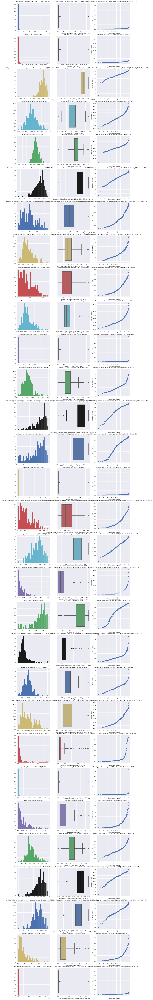

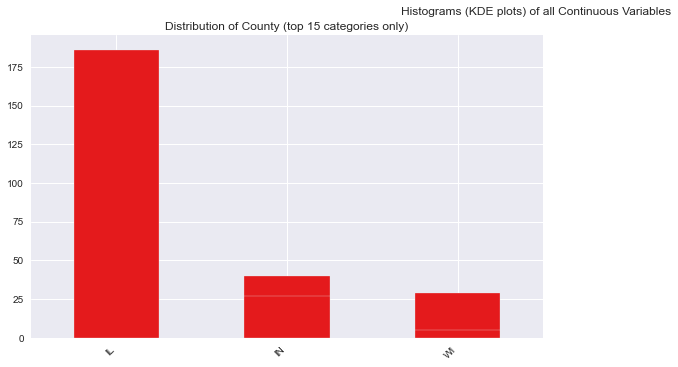

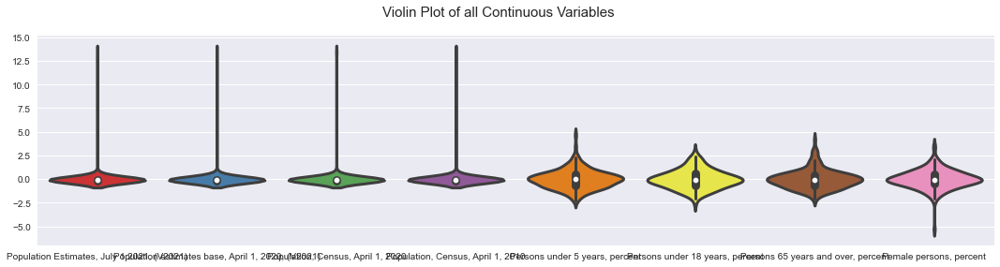

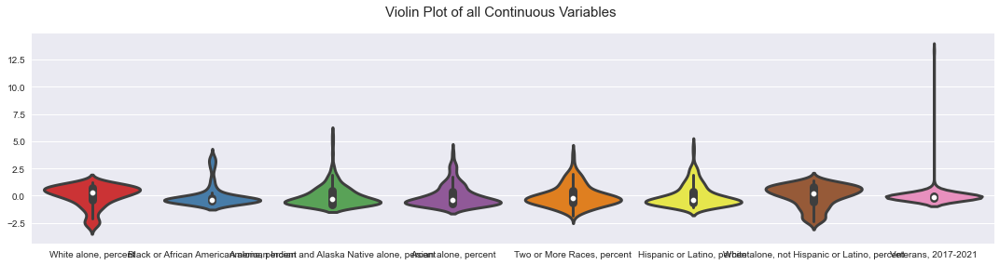

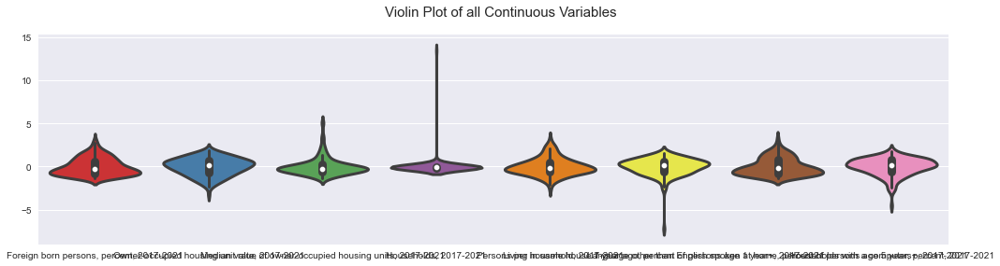

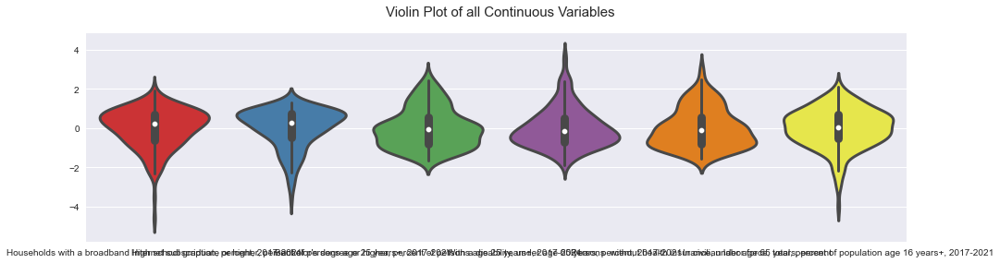

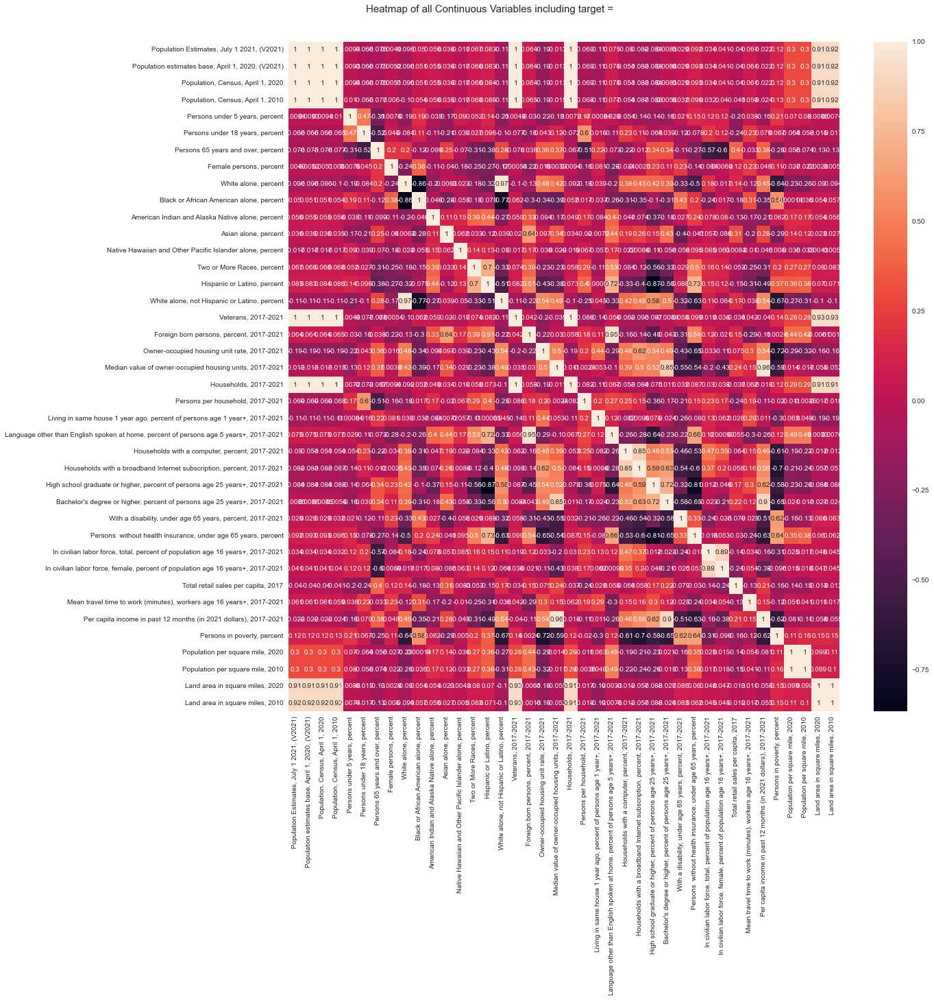

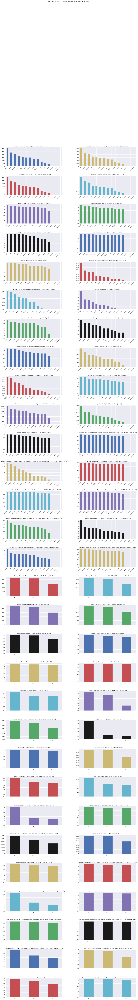

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     C:\Users\Albert\AppData\Roaming\nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     C:\Users\Albert\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     C:\Users\Albert\AppData\Roaming\nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     C:\Users\Albert\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     C:\Users\Albert\AppData\Roaming\nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_dat

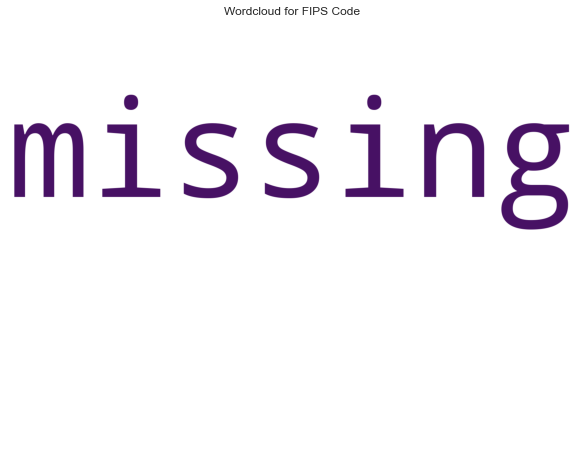

All Plots done
Time to run AutoViz = 109 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [3]:
plt.style.use('seaborn')

av = AutoViz_Class()
dft = av.AutoViz(filename = '',
                 dfte = population_data)

In [4]:
# sd_df = pd.read_csv("../data/supply_demand_ratio.csv")

# sd_df = sd_df.head(218)
# sd_df

In [5]:
# df_new = pd.merge(population_data, sd_df, on='City')

# df_new 

In [6]:
list(df.columns)

['City',
 'State',
 'County',
 'Population Estimates, July 1 2022, (V2022)',
 'Population Estimates, July 1 2021, (V2021)',
 'Population estimates base, April 1, 2020, (V2022)',
 'Population estimates base, April 1, 2020, (V2021)',
 'Population, percent change - April 1, 2020 (estimates base) to July 1, 2022, (V2022)',
 'Population, percent change - April 1, 2020 (estimates base) to July 1, 2021, (V2021)',
 'Population, Census, April 1, 2020',
 'Population, Census, April 1, 2010',
 'Persons under 5 years, percent',
 'Persons under 18 years, percent',
 'Persons 65 years and over, percent',
 'Female persons, percent',
 'White alone, percent',
 'Black or African American alone, percent',
 'American Indian and Alaska Native alone, percent',
 'Asian alone, percent',
 'Native Hawaiian and Other Pacific Islander alone, percent',
 'Two or More Races, percent',
 'Hispanic or Latino, percent',
 'White alone, not Hispanic or Latino, percent',
 'Veterans, 2017-2021',
 'Foreign born persons, percen

<a id='edu'></a>
## 3. Education

1. Find the average percentage of:
    - High school graduate percentage for all city 
    - Bachelor's degree percentage for all city 
2. Find the average supply/demand ratio by:
    - Below average high school graduation
    - Above High School graduation and Below Bachelor's degree
    - Above Bachelor's degree

In [7]:
df['Lower than High school graduate, percent of persons age 25 years+, 2017-2021'] = 1 - df['High school graduate or higher, percent of persons age 25 years+, 2017-2021']




education_col = ['City','State','County',
                 'Lower than High school graduate, percent of persons age 25 years+, 2017-2021',
                 'High school graduate or higher, percent of persons age 25 years+, 2017-2021',
                 "Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021"]


education_df = df[education_col]

education_df

,City,State,County,"Lower than High school graduate, percent of persons age 25 years+, 2017-2021","High school graduate or higher, percent of persons age 25 years+, 2017-2021","Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021"
0,Addison,DuPage,IL,0.203,0.797,0.238
1,Algonquin,McHenry,IL,0.051,0.949,0.442
2,Alsip,Cook,IL,0.111,0.889,0.208
3,Antioch,Lake,IL,0.045,0.955,0.406
4,Arlington Heights,Cook,IL,0.037,0.963,0.595
...,...,...,...,...,...,...
213,Woodridge,DuPage,IL,0.047,0.953,0.478
214,Woodstock,McHenry,IL,0.119,0.881,0.315
215,Worth,Cook,IL,0.093,0.907,0.187
216,Yorkville,Kendall,IL,0.042,0.958,0.342


In [8]:
print(education_df["Lower than High school graduate, percent of persons age 25 years+, 2017-2021"].mean())

print(education_df["High school graduate or higher, percent of persons age 25 years+, 2017-2021"].mean())

print(education_df["Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021"].mean())

0.08564864864864868
0.9143513513513511
0.39970810810810786


In [9]:
def education_conditions(x):
    if (x["Lower than High school graduate, percent of persons age 25 years+, 2017-2021"] > 0.08564):
        return "1"
    elif (x["High school graduate or higher, percent of persons age 25 years+, 2017-2021"] > 0.91435 \
             and x["Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021"] < 0.39971):
        return "2"
    elif pd.isna(x["Lower than High school graduate, percent of persons age 25 years+, 2017-2021"]):
        return np.nan
    else:
        return "3"

In [10]:
pd.set_option('display.max_rows', 500)

education_df['education_level'] = education_df.apply(education_conditions, axis=1)

education_df

,City,State,County,"Lower than High school graduate, percent of persons age 25 years+, 2017-2021","High school graduate or higher, percent of persons age 25 years+, 2017-2021","Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021",education_level
0,Addison,DuPage,IL,0.203,0.797,0.238,1
1,Algonquin,McHenry,IL,0.051,0.949,0.442,3
2,Alsip,Cook,IL,0.111,0.889,0.208,1
3,Antioch,Lake,IL,0.045,0.955,0.406,3
4,Arlington Heights,Cook,IL,0.037,0.963,0.595,3
5,Aurora,Kane,IL,0.196,0.804,0.348,1
6,Barrington,Lake,IL,0.028,0.972,0.708,3
7,Bartlett,DuPage,IL,0.067,0.933,0.447,3
8,Batavia,Kane,IL,0.037,0.963,0.552,3
9,Bensenville,DuPage,IL,0.183,0.817,0.227,1


Shape of your Data Set loaded: (218, 7)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
Data cleaning improvement suggestions. Complete them before proceeding to ML modeling.


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
City,218,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
"Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021",164,float64,33,15.137615,75.229358,0,fill missing
"Lower than High school graduate, percent of persons age 25 years+, 2017-2021",115,float64,33,15.137615,52.752294,0,"fill missing, skewed: cap or drop outliers"
"High school graduate or higher, percent of persons age 25 years+, 2017-2021",115,float64,33,15.137615,52.752294,0,"fill missing, skewed: cap or drop outliers"
State,15,object,0,0.000000,6.880734,1,
County,3,object,0,0.000000,1.376147,5,
education_level,3,object,33,15.137615,1.376147,36,"fill missing, fix mixed data types"


    7 Predictors classified...
        1 variables removed since they were ID or low-information variables
        List of variables removed: ['City']
Number of All Scatter Plots = 6


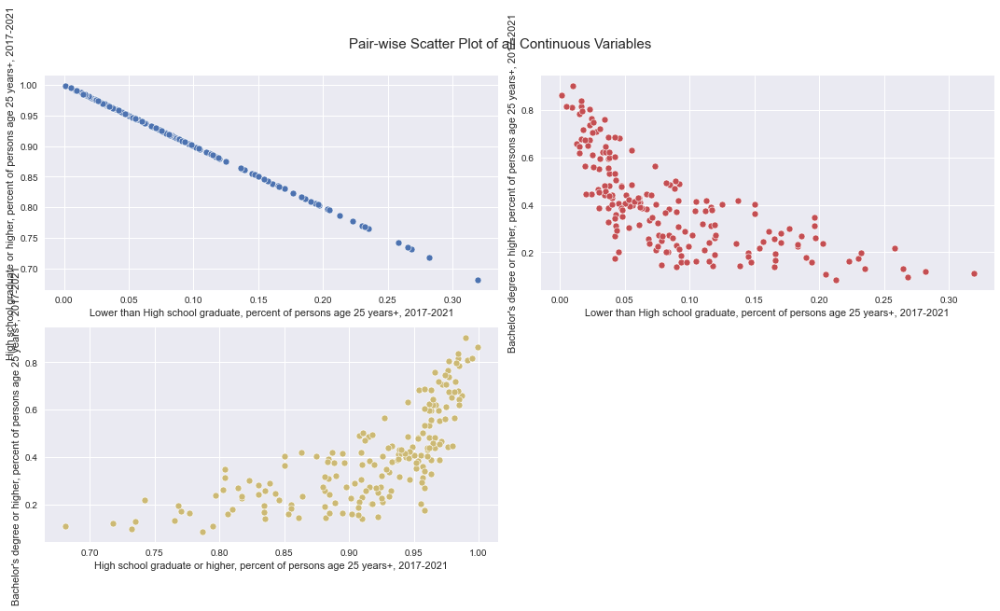

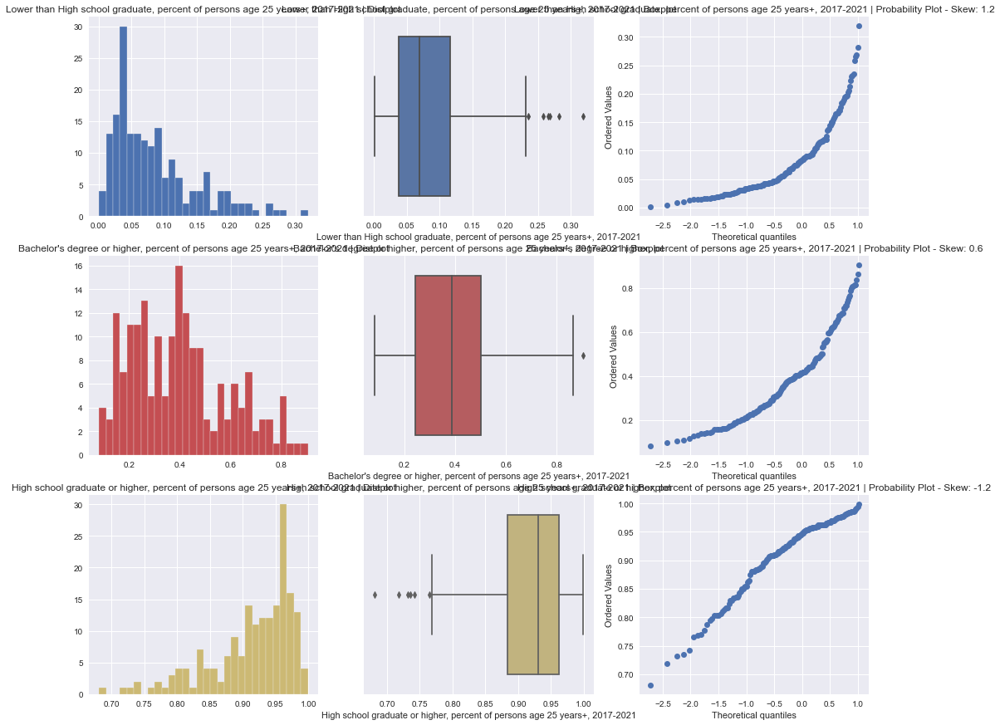

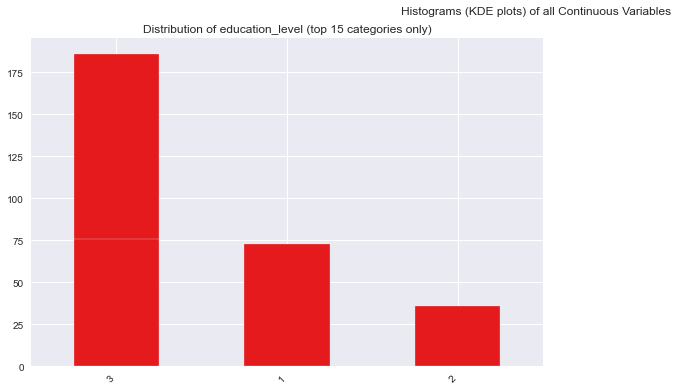

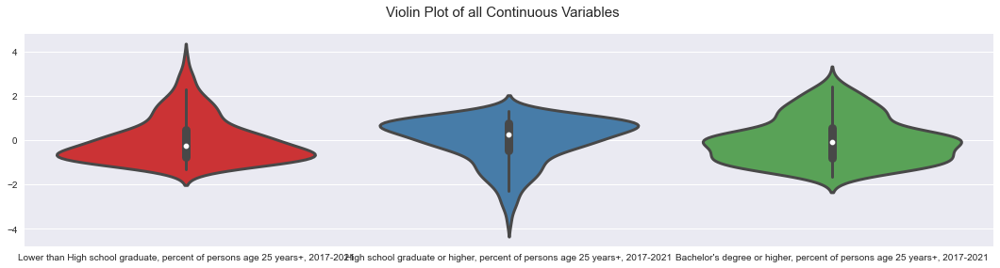

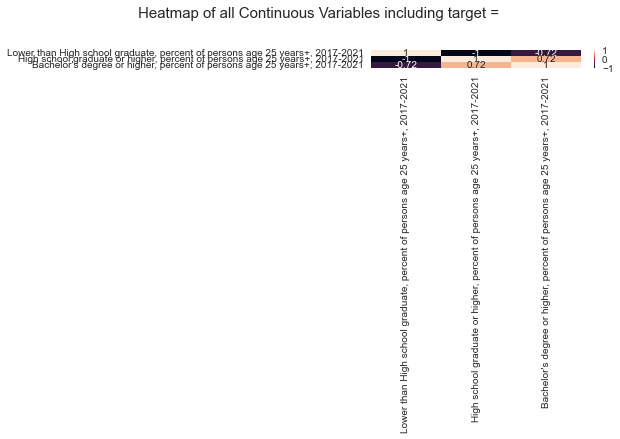

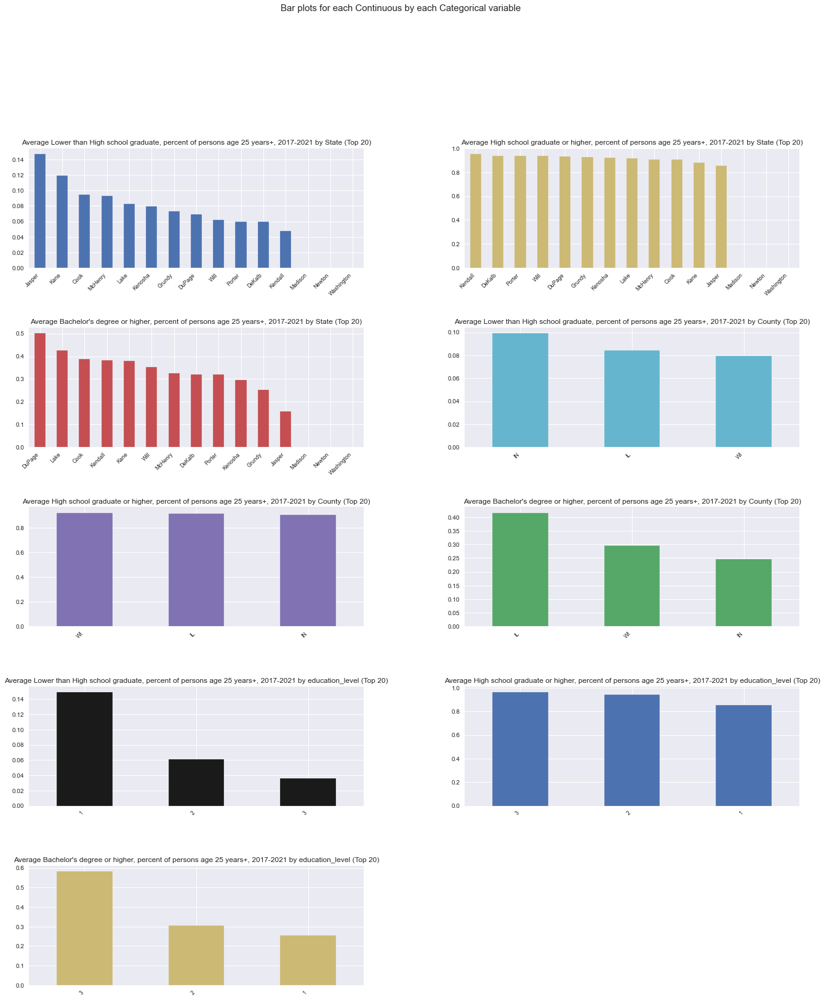

All Plots done
Time to run AutoViz = 4 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [11]:
plt.style.use('seaborn')

av = AutoViz_Class()
dft = av.AutoViz(filename = '',
                 dfte = education_df,
                 verbose=1)

<a id='wealth'></a>
## 4. Wealth

1. Income (__already have in pop data__):
    - Show line graph
        - X-axis: Total Average Income by city
        - Y-axis: supply/demand ratio by city
2. Property Value (use bolded):
    - How to combine the values to identify the good property status?
        - __Median value of owner-occupied housing units__
        - Median selected monthly owner costs with a mortgage
        - Median selected monthly owner costs without a mortgage
        - Median gross rent
    - Show line graph
        - X-axis: good property values by city 
        - Y-axis: supply/demand ratio by city 
        
 

In [12]:
wealth_col = ['City','State','County',
                 'Median household income (in 2021 dollars), 2017-2021',
                 'Median value of owner-occupied housing units, 2017-2021']


wealth_df = df[wealth_col]

wealth_df

,City,State,County,"Median household income (in 2021 dollars), 2017-2021","Median value of owner-occupied housing units, 2017-2021"
0,Addison,DuPage,IL,75960,271500.0
1,Algonquin,McHenry,IL,115346,273600.0
2,Alsip,Cook,IL,59123,172000.0
3,Antioch,Lake,IL,100705,245100.0
4,Arlington Heights,Cook,IL,106996,360900.0
5,Aurora,Kane,IL,79642,208500.0
6,Barrington,Lake,IL,126250,477500.0
7,Bartlett,DuPage,IL,114121,292100.0
8,Batavia,Kane,IL,109146,316800.0
9,Bensenville,DuPage,IL,68532,227000.0


Shape of your Data Set loaded: (218, 5)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Removing ['Median household income (in 2021 dollars), 2017-2021'] column(s) due to mixed data type detected...
Data cleaning improvement suggestions. Complete them before proceeding to ML modeling.


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
City,218,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
"Median household income (in 2021 dollars), 2017-2021",183,object,33,15.137615,83.944954,1,"combine rare categories, fill missing, fix mixed data types"
"Median value of owner-occupied housing units, 2017-2021",182,float64,33,15.137615,83.486239,0,"fill missing, skewed: cap or drop outliers"
State,15,object,0,0.000000,6.880734,1,
County,3,object,0,0.000000,1.376147,5,


    5 Predictors classified...
        2 variables removed since they were ID or low-information variables
        List of variables removed: ['City', 'Median household income (in 2021 dollars), 2017-2021']


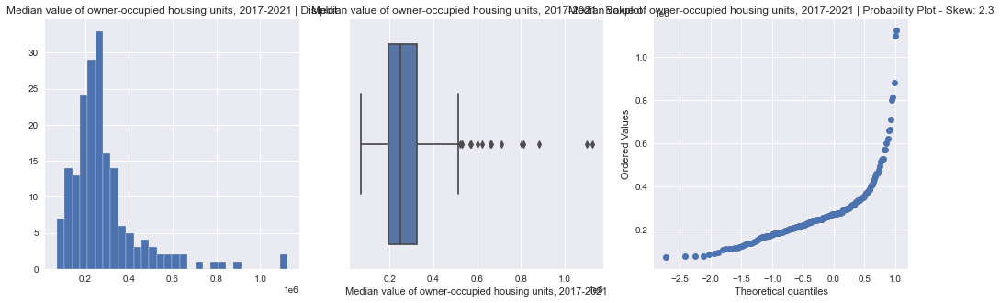

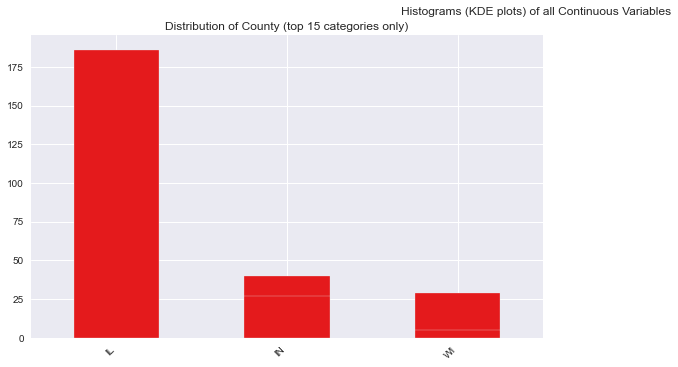

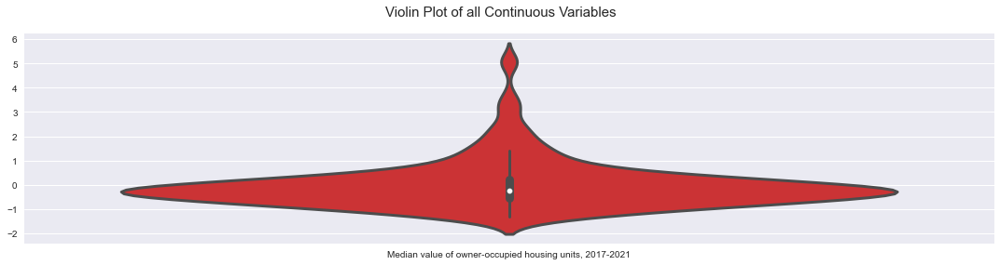

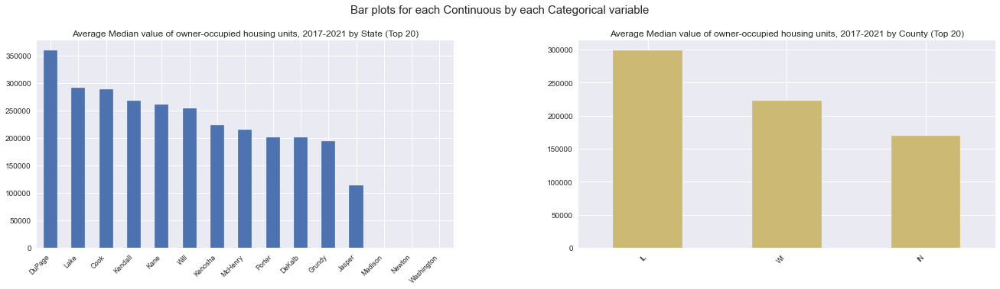

All Plots done
Time to run AutoViz = 1 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [13]:
plt.style.use('seaborn')

av = AutoViz_Class()
dft = av.AutoViz(filename = '',
                 dfte = wealth_df,
                 verbose=1)

<a id='age'></a>
## 5. Age

1. Find the between 18-65 group percentage 
2. Show line graph:
    - Trend of under 18 group 
        - X-axis: the percentage of this age group 
        - Y-axis: the supply/demand ratio 
    - Trend of between 18-65 group 
    - Trend of over 65 group 

In [14]:
df['Persons 18 years and older and under 65, percent'] = 1 - df['Persons under 18 years, percent'] \
- df['Persons 65 years and over, percent']



age_col = ['City','State','County', 
           'Persons under 18 years, percent',
           'Persons 18 years and older and under 65, percent',
           'Persons 65 years and over, percent']

age_df = df[age_col]

age_df

,City,State,County,"Persons under 18 years, percent","Persons 18 years and older and under 65, percent","Persons 65 years and over, percent"
0,Addison,DuPage,IL,0.221,0.622,0.157
1,Algonquin,McHenry,IL,0.218,0.651,0.131
2,Alsip,Cook,IL,0.244,0.581,0.175
3,Antioch,Lake,IL,0.260,0.622,0.118
4,Arlington Heights,Cook,IL,0.232,0.574,0.194
5,Aurora,Kane,IL,0.278,0.623,0.099
6,Barrington,Lake,IL,0.296,0.504,0.200
7,Bartlett,DuPage,IL,0.229,0.624,0.147
8,Batavia,Kane,IL,0.265,0.580,0.155
9,Bensenville,DuPage,IL,0.251,0.629,0.120


Shape of your Data Set loaded: (218, 6)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
Data cleaning improvement suggestions. Complete them before proceeding to ML modeling.


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
City,218,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
"Persons 18 years and older and under 65, percent",121,float64,33,15.137615,55.504587,0,fill missing
"Persons under 18 years, percent",106,float64,33,15.137615,48.623853,0,fill missing
"Persons 65 years and over, percent",106,float64,33,15.137615,48.623853,0,fill missing
State,15,object,0,0.000000,6.880734,1,
County,3,object,0,0.000000,1.376147,5,


    6 Predictors classified...
        1 variables removed since they were ID or low-information variables
        List of variables removed: ['City']
Number of All Scatter Plots = 6


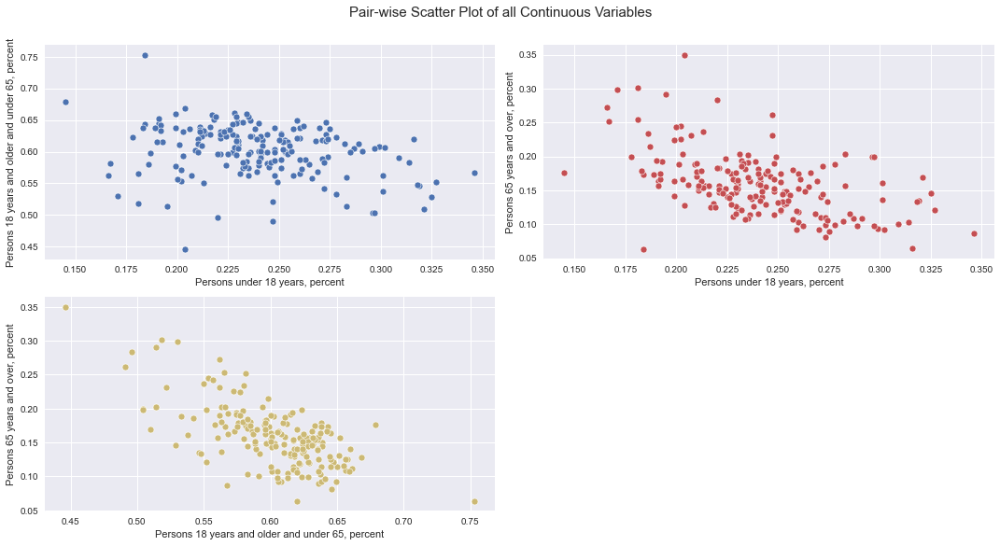

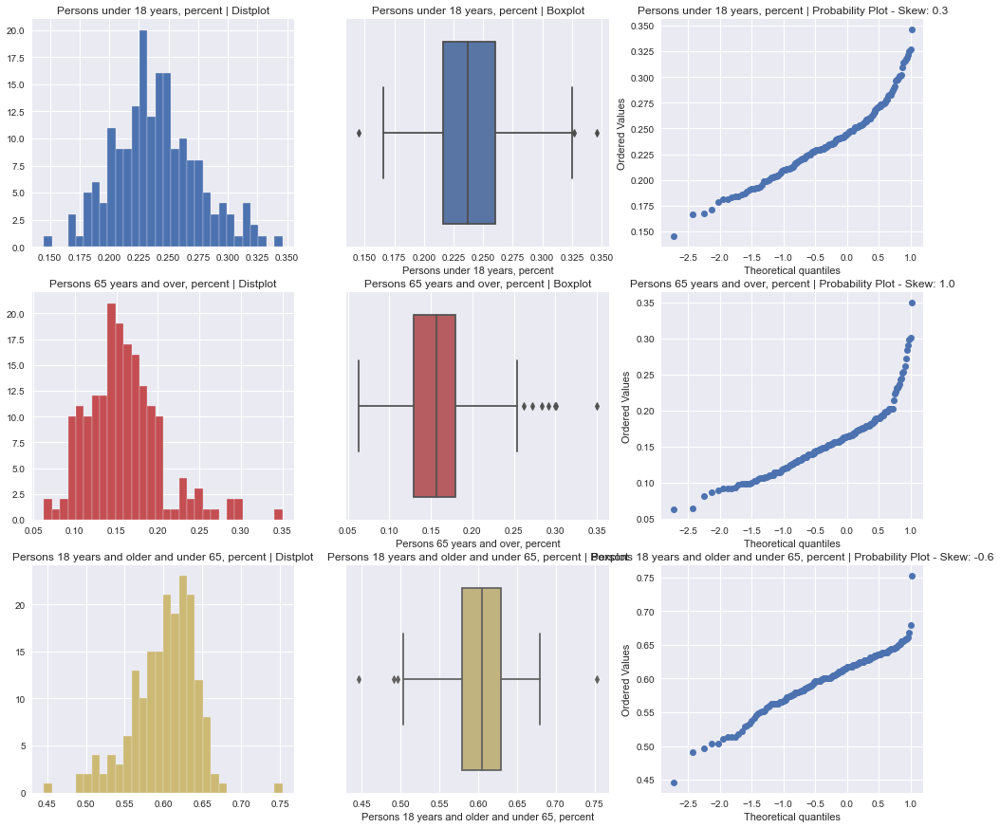

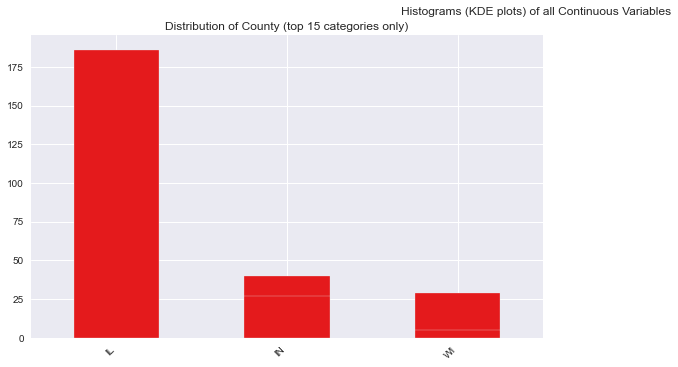

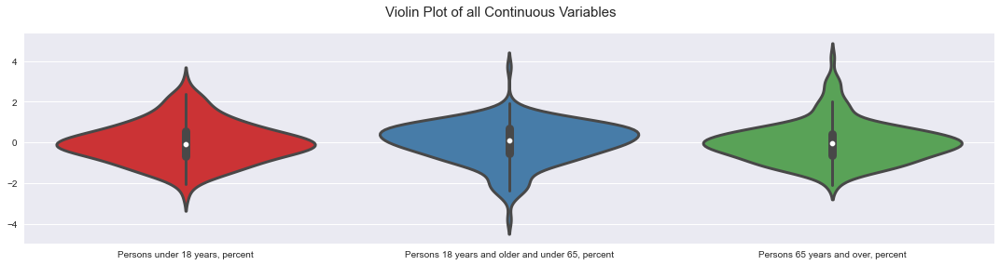

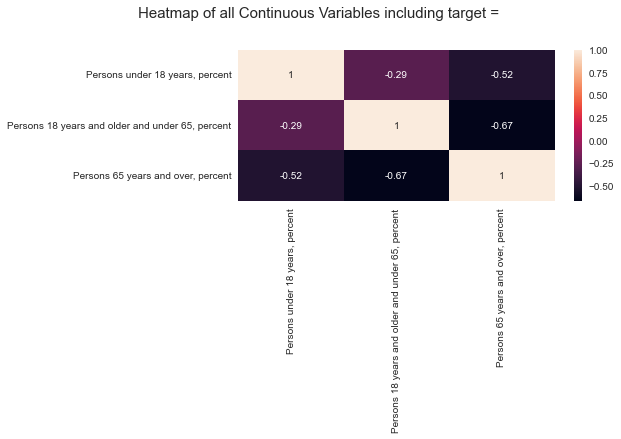

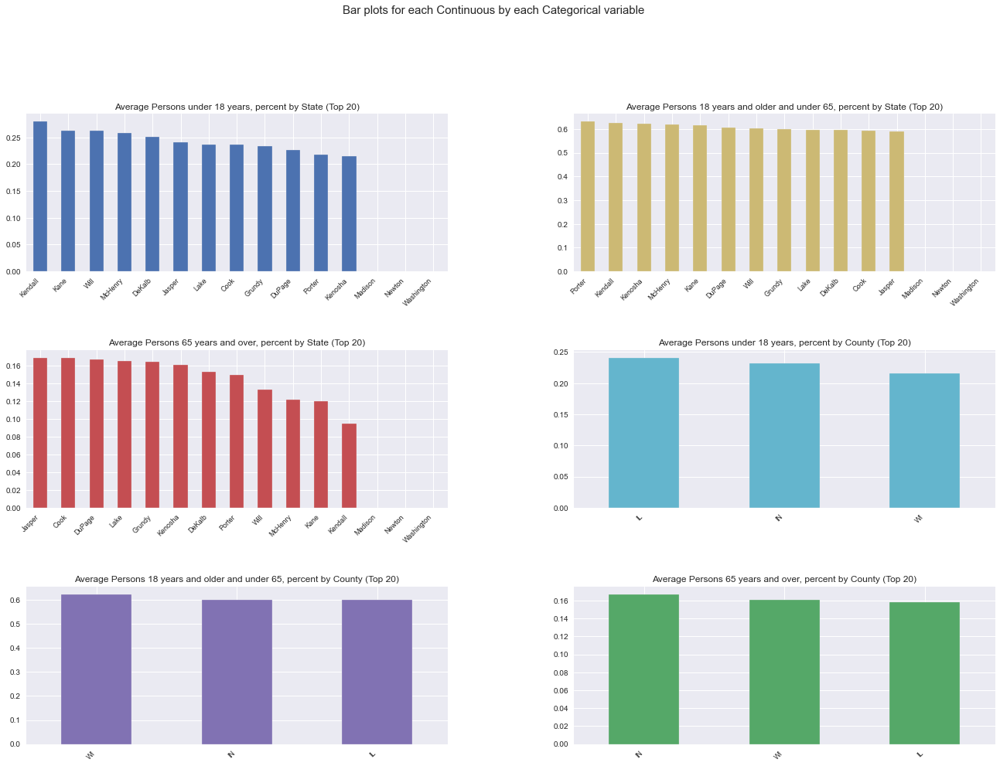

All Plots done
Time to run AutoViz = 3 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [15]:
plt.style.use('seaborn')

av = AutoViz_Class()
dft = av.AutoViz(filename = '',
                 dfte = age_df,
                 verbose=1)

<a id='eth'></a>
## 6. Ethnicity

1. Show the line graph for each ethnicity groups 
    - White percentage 
        - X-axis: the percentage of this ethnicity group 
        - Y-axis: the supply/demand ratio 
    - Black 
    - Native American 
    - Asian 
    - Pacific islander 

In [16]:
ethnicity_col = ['City','State','County', 
                 'White alone, percent',
                 'Black or African American alone, percent',
                 'American Indian and Alaska Native alone, percent',
                 'Asian alone, percent',
                 'Native Hawaiian and Other Pacific Islander alone, percent',
                 'Hispanic or Latino, percent'
                 ]


ethnicity_df = df[ethnicity_col]

Shape of your Data Set loaded: (218, 9)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
Data cleaning improvement suggestions. Complete them before proceeding to ML modeling.


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
City,218,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
"White alone, percent",158,float64,33,15.137615,72.477064,0,"fill missing, skewed: cap or drop outliers"
"Hispanic or Latino, percent",144,float64,33,15.137615,66.055046,0,"fill missing, skewed: cap or drop outliers"
"Black or African American alone, percent",108,float64,33,15.137615,49.541284,0,"fill missing, skewed: cap or drop outliers"
"Asian alone, percent",102,float64,33,15.137615,46.788991,0,"fill missing, skewed: cap or drop outliers"
"American Indian and Alaska Native alone, percent",17,float64,33,15.137615,7.798165,0,"fill missing, skewed: cap or drop outliers"
State,15,object,0,0.000000,6.880734,1,
"Native Hawaiian and Other Pacific Islander alone, percent",5,float64,33,15.137615,2.293578,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
County,3,object,0,0.000000,1.376147,5,


    9 Predictors classified...
        1 variables removed since they were ID or low-information variables
        List of variables removed: ['City']
Number of All Scatter Plots = 21


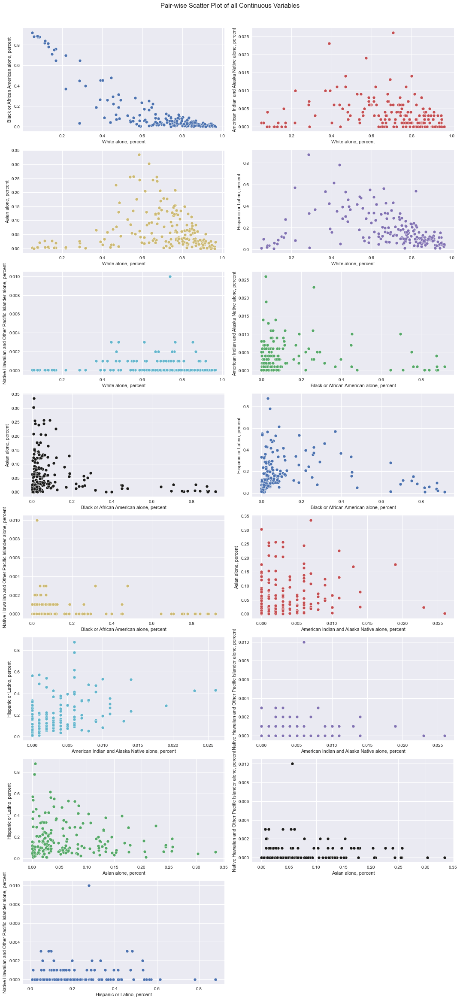

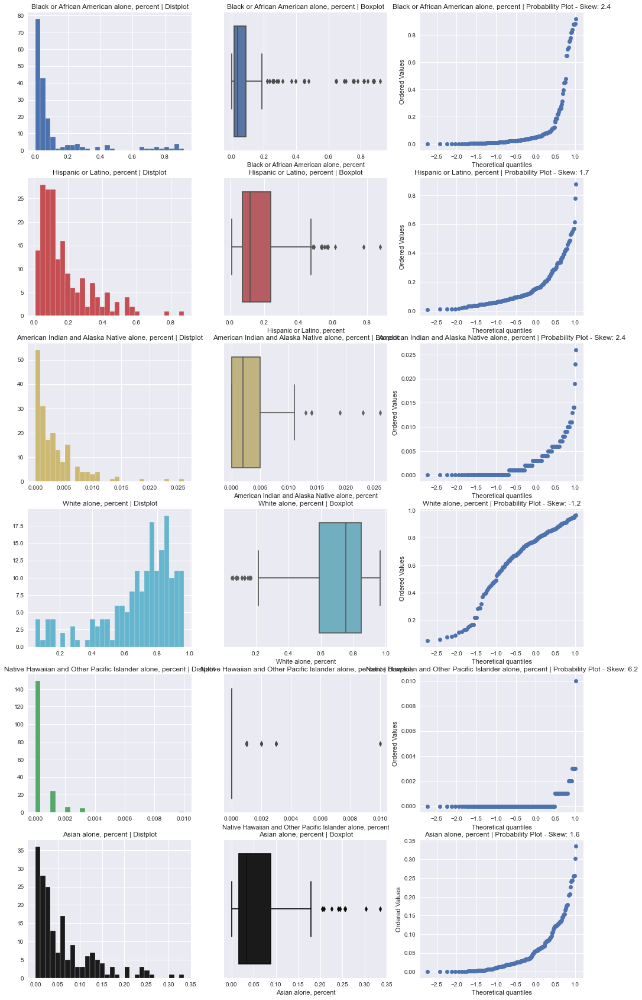

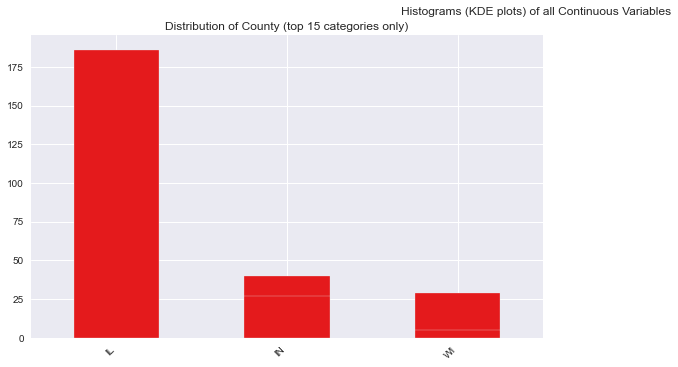

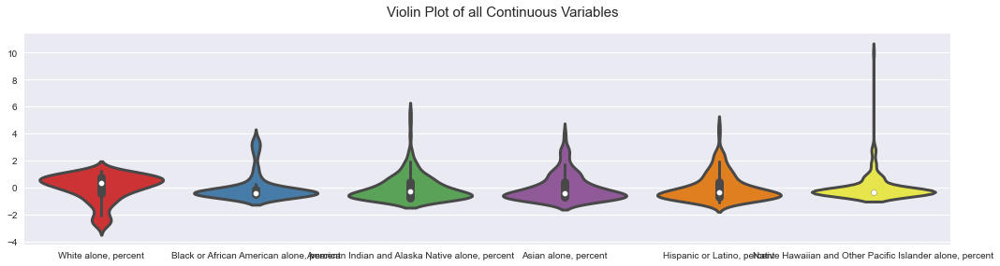

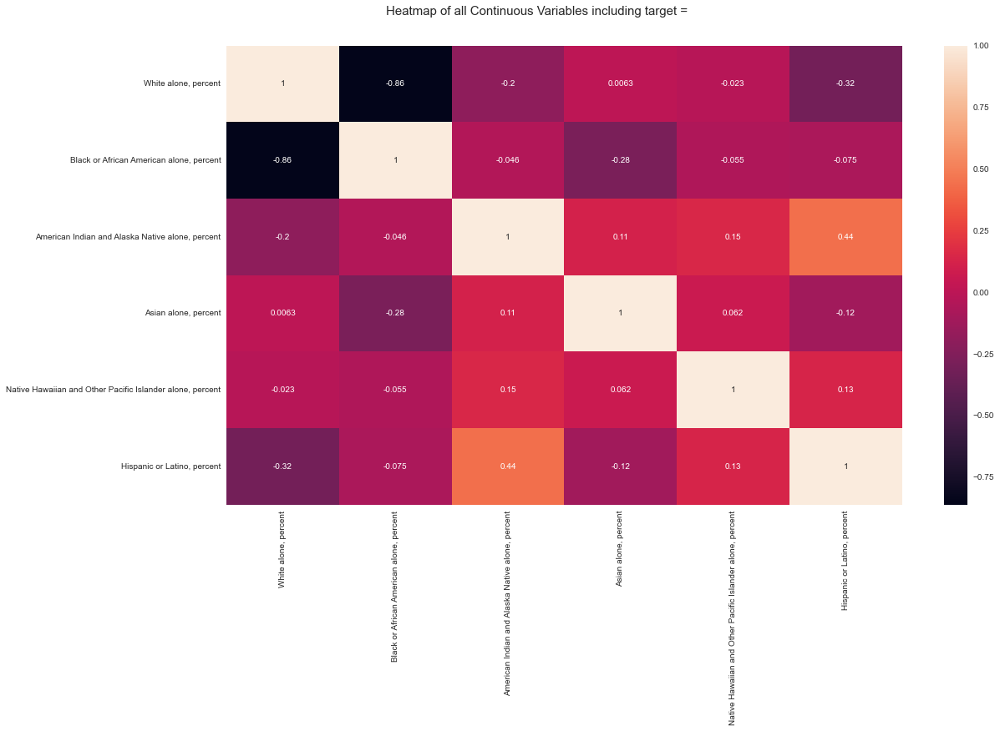

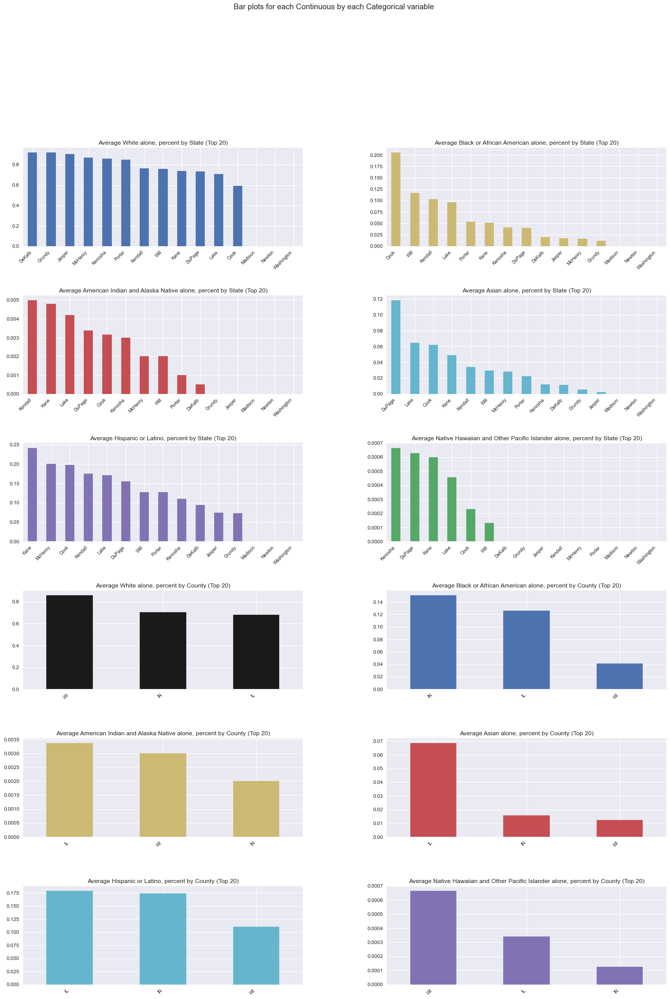

All Plots done
Time to run AutoViz = 7 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [17]:
plt.style.use('seaborn')

av = AutoViz_Class()
dft = av.AutoViz(filename = '',
                 dfte = ethnicity_df,
                 verbose=1)

<a id='json'></a>
## 7. Combine Data/ JSON

In [18]:
combined_df = pd.merge(education_df, age_df, on=['City', 'State', 'County'])
combined_df = pd.merge(combined_df, wealth_df, on=['City', 'State', 'County'])
combined_df = pd.merge(combined_df, ethnicity_df, on=['City', 'State', 'County'])

multiperspective_data = combined_df.drop(columns=['Lower than High school graduate, percent of persons age 25 years+, 2017-2021',
                                                  'High school graduate or higher, percent of persons age 25 years+, 2017-2021',
                                                  "Bachelor's degree or higher, percent of persons age 25 years+, 2017-2021",
                                                  'State',
                                                  'County'])

multiperspective_data.rename(
    columns={'education_level': 'EDUCATION_LEVEL',
             'Persons under 18 years, percent': 'AGE_UNDER_18',
             'Persons 18 years and older and under 65, percent': 'AGE_BETWEEN_18_65',
             'Persons 65 years and over, percent': 'AGE_OVER_65',
             'Median household income (in 2021 dollars), 2017-2021': 'WEALTH_MEDIAN_INCOME',
             'Median value of owner-occupied housing units, 2017-2021': 'WEALTH_MEDIAN_HOME_VALUE',
             'White alone, percent': 'ETHNICITY_WHITE',
             'Black or African American alone, percent': 'ETHNICITY_BLACK',
             'American Indian and Alaska Native alone, percent': 'ETHNICITY_NATIVE_AM',
             'Asian alone, percent': 'ETHNICITY_ASIAN',
             'Native Hawaiian and Other Pacific Islander alone, percent': 'ETHNICITY_PAC_ISLANDER',
             'Hispanic or Latino, percent': 'ETHNICITY_HISPANIC_LATINO'}, inplace=True)


multiperspective_data

,City,EDUCATION_LEVEL,AGE_UNDER_18,AGE_BETWEEN_18_65,AGE_OVER_65,WEALTH_MEDIAN_INCOME,WEALTH_MEDIAN_HOME_VALUE,ETHNICITY_WHITE,ETHNICITY_BLACK,ETHNICITY_NATIVE_AM,ETHNICITY_ASIAN,ETHNICITY_PAC_ISLANDER,ETHNICITY_HISPANIC_LATINO
0,Addison,1,0.221,0.622,0.157,75960,271500.0,0.623,0.047,0.006,0.084,0.000,0.416
1,Algonquin,3,0.218,0.651,0.131,115346,273600.0,0.837,0.026,0.003,0.068,0.000,0.102
2,Alsip,1,0.244,0.581,0.175,59123,172000.0,0.597,0.235,0.006,0.021,0.000,0.246
3,Antioch,3,0.260,0.622,0.118,100705,245100.0,0.864,0.022,0.004,0.034,0.000,0.069
4,Arlington Heights,3,0.232,0.574,0.194,106996,360900.0,0.788,0.027,0.002,0.105,0.000,0.091
5,Aurora,1,0.278,0.623,0.099,79642,208500.0,0.527,0.109,0.009,0.103,0.001,0.415
6,Barrington,3,0.296,0.504,0.200,126250,477500.0,0.848,0.017,0.000,0.089,0.000,0.026
7,Bartlett,3,0.229,0.624,0.147,114121,292100.0,0.691,0.033,0.013,0.169,0.001,0.144
8,Batavia,3,0.265,0.580,0.155,109146,316800.0,0.883,0.023,0.002,0.015,0.000,0.088
9,Bensenville,1,0.251,0.629,0.120,68532,227000.0,0.610,0.059,0.008,0.039,0.003,0.483


In [19]:
json_data = multiperspective_data.to_json(orient = 'records')

In [20]:
json_data

'[{"City":"Addison","EDUCATION_LEVEL":"1","AGE_UNDER_18":0.221,"AGE_BETWEEN_18_65":0.622,"AGE_OVER_65":0.157,"WEALTH_MEDIAN_INCOME":75960,"WEALTH_MEDIAN_HOME_VALUE":271500.0,"ETHNICITY_WHITE":0.623,"ETHNICITY_BLACK":0.047,"ETHNICITY_NATIVE_AM":0.006,"ETHNICITY_ASIAN":0.084,"ETHNICITY_PAC_ISLANDER":0.0,"ETHNICITY_HISPANIC_LATINO":0.416},{"City":"Algonquin","EDUCATION_LEVEL":"3","AGE_UNDER_18":0.218,"AGE_BETWEEN_18_65":0.651,"AGE_OVER_65":0.131,"WEALTH_MEDIAN_INCOME":115346,"WEALTH_MEDIAN_HOME_VALUE":273600.0,"ETHNICITY_WHITE":0.837,"ETHNICITY_BLACK":0.026,"ETHNICITY_NATIVE_AM":0.003,"ETHNICITY_ASIAN":0.068,"ETHNICITY_PAC_ISLANDER":0.0,"ETHNICITY_HISPANIC_LATINO":0.102},{"City":"Alsip","EDUCATION_LEVEL":"1","AGE_UNDER_18":0.244,"AGE_BETWEEN_18_65":0.581,"AGE_OVER_65":0.175,"WEALTH_MEDIAN_INCOME":59123,"WEALTH_MEDIAN_HOME_VALUE":172000.0,"ETHNICITY_WHITE":0.597,"ETHNICITY_BLACK":0.235,"ETHNICITY_NATIVE_AM":0.006,"ETHNICITY_ASIAN":0.021,"ETHNICITY_PAC_ISLANDER":0.0,"ETHNICITY_HISPANIC_LATI